<a href="https://colab.research.google.com/github/zergswim/GAN/blob/main/Pix2Pix_for_Facades2.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
import os
import glob
import numpy as np
import matplotlib.pyplot as plt
from PIL import Image

import torch
import torch.nn as nn

from torch.utils.data import Dataset
from torch.utils.data import DataLoader
import torchvision.transforms as transforms
from torchvision.utils import save_image

In [2]:
%%capture
!wget http://efrosgans.eecs.berkeley.edu/pix2pix/datasets/facades.tar.gz -O facades.tar.gz
!tar -zxvf facades.tar.gz -C ./

In [3]:
print("학습 데이터셋 A와 B의 개수:", len(next(os.walk('./facades/train/'))[2]))
print("평가 데이터셋 A와 B의 개수:", len(next(os.walk('./facades/val/'))[2]))
print("테스트 데이터셋 A와 B의 개수:", len(next(os.walk('./facades/test/'))[2]))

학습 데이터셋 A와 B의 개수: 400
평가 데이터셋 A와 B의 개수: 100
테스트 데이터셋 A와 B의 개수: 106


이미지 크기: (512, 256)


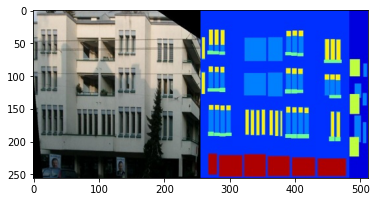

In [4]:
# 한 쌍의 이미지 출력(왼쪽은 정답 이미지, 오른쪽은 조건 이미지)
image = Image.open('./facades/train/1.jpg')
print("이미지 크기:", image.size)

plt.imshow(image)
plt.show()

In [5]:
class ImageDataset(Dataset):
    def __init__(self, root, transforms_=None, mode="train"):
        self.transform = transforms_

        self.files = sorted(glob.glob(os.path.join(root, mode) + "/*.jpg"))
        # 데이터의 개수가 적기 때문에 테스트 데이터를 학습 시기에 사용
        if mode == "train":
            self.files.extend(sorted(glob.glob(os.path.join(root, "test") + "/*.jpg")))

    def __getitem__(self, index):
        img = Image.open(self.files[index % len(self.files)])
        w, h = img.size
        img_A = img.crop((0, 0, w / 2, h)) # 이미지의 왼쪽 절반
        img_B = img.crop((w / 2, 0, w, h)) # 이미지의 오른쪽 절반

        # 데이터 증진(data augmentation)을 위한 좌우 반전(horizontal flip)
        if np.random.random() < 0.5:
            img_A = Image.fromarray(np.array(img_A)[:, ::-1, :], "RGB")
            img_B = Image.fromarray(np.array(img_B)[:, ::-1, :], "RGB")

        img_A = self.transform(img_A)
        img_B = self.transform(img_B)

        return {"A": img_A, "B": img_B}

    def __len__(self):
        return len(self.files)

In [6]:
transforms_ = transforms.Compose([
    transforms.Resize((256, 256), Image.BICUBIC),
    transforms.ToTensor(),
    transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5))
])

train_dataset = ImageDataset("facades", transforms_=transforms_)
val_dataset = ImageDataset("facades", transforms_=transforms_)

train_dataloader = DataLoader(train_dataset, batch_size=10, shuffle=True, num_workers=2)
val_dataloader = DataLoader(val_dataset, batch_size=10, shuffle=True, num_workers=2)

/usr/local/lib/python3.7/dist-packages/torchvision/transforms/transforms.py:333: UserWarning: Argument interpolation should be of type InterpolationMode instead of int. Please, use InterpolationMode enum.
  "Argument interpolation should be of type InterpolationMode instead of int. "


In [7]:
# U-Net 아키텍처의 다운 샘플링(Down Sampling) 모듈
class UNetDown(nn.Module):
    def __init__(self, in_channels, out_channels, normalize=True, dropout=0.0):
        super(UNetDown, self).__init__()
        # 너비와 높이가 2배씩 감소
        layers = [nn.Conv2d(in_channels, out_channels, kernel_size=4, stride=2, padding=1, bias=False)]
        if normalize:
            layers.append(nn.InstanceNorm2d(out_channels))
        layers.append(nn.LeakyReLU(0.2))
        if dropout:
            layers.append(nn.Dropout(dropout))
        self.model = nn.Sequential(*layers)

    def forward(self, x):
        return self.model(x)


# U-Net 아키텍처의 업 샘플링(Up Sampling) 모듈: Skip Connection 사용
class UNetUp(nn.Module):
    def __init__(self, in_channels, out_channels, dropout=0.0):
        super(UNetUp, self).__init__()
        # 너비와 높이가 2배씩 증가
        layers = [nn.ConvTranspose2d(in_channels, out_channels, kernel_size=4, stride=2, padding=1, bias=False)]
        layers.append(nn.InstanceNorm2d(out_channels))
        layers.append(nn.ReLU(inplace=True))
        if dropout:
            layers.append(nn.Dropout(dropout))
        self.model = nn.Sequential(*layers)

    def forward(self, x, skip_input):
        x = self.model(x)
        x = torch.cat((x, skip_input), 1) # 채널 레벨에서 합치기(concatenation)

        return x


# U-Net 생성자(Generator) 아키텍처
class GeneratorUNet(nn.Module):
    def __init__(self, in_channels=3, out_channels=3):
        super(GeneratorUNet, self).__init__()

        self.down1 = UNetDown(in_channels, 64, normalize=False) # 출력: [64 X 128 X 128]
        self.down2 = UNetDown(64, 128) # 출력: [128 X 64 X 64]
        self.down3 = UNetDown(128, 256) # 출력: [256 X 32 X 32]
        self.down4 = UNetDown(256, 512, dropout=0.5) # 출력: [512 X 16 X 16]
        self.down5 = UNetDown(512, 512, dropout=0.5) # 출력: [512 X 8 X 8]
        self.down6 = UNetDown(512, 512, dropout=0.5) # 출력: [512 X 4 X 4]
        self.down7 = UNetDown(512, 512, dropout=0.5) # 출력: [512 X 2 X 2]
        self.down8 = UNetDown(512, 512, normalize=False, dropout=0.5) # 출력: [512 X 1 X 1]

        # Skip Connection 사용(출력 채널의 크기 X 2 == 다음 입력 채널의 크기)
        self.up1 = UNetUp(512, 512, dropout=0.5) # 출력: [1024 X 2 X 2]
        self.up2 = UNetUp(1024, 512, dropout=0.5) # 출력: [1024 X 4 X 4]
        self.up3 = UNetUp(1024, 512, dropout=0.5) # 출력: [1024 X 8 X 8]
        self.up4 = UNetUp(1024, 512, dropout=0.5) # 출력: [1024 X 16 X 16]
        self.up5 = UNetUp(1024, 256) # 출력: [512 X 32 X 32]
        self.up6 = UNetUp(512, 128) # 출력: [256 X 64 X 64]
        self.up7 = UNetUp(256, 64) # 출력: [128 X 128 X 128]

        self.final = nn.Sequential(
            nn.Upsample(scale_factor=2), # 출력: [128 X 256 X 256]
            nn.ZeroPad2d((1, 0, 1, 0)),
            nn.Conv2d(128, out_channels, kernel_size=4, padding=1), # 출력: [3 X 256 X 256]
            nn.Tanh(),
        )

    def forward(self, x):
        # 인코더부터 디코더까지 순전파하는 U-Net 생성자(Generator)
        d1 = self.down1(x)
        d2 = self.down2(d1)
        d3 = self.down3(d2)
        d4 = self.down4(d3)
        d5 = self.down5(d4)
        d6 = self.down6(d5)
        d7 = self.down7(d6)
        d8 = self.down8(d7)
        u1 = self.up1(d8, d7)
        u2 = self.up2(u1, d6)
        u3 = self.up3(u2, d5)
        u4 = self.up4(u3, d4)
        u5 = self.up5(u4, d3)
        u6 = self.up6(u5, d2)
        u7 = self.up7(u6, d1)

        return self.final(u7)


# U-Net 판별자(Discriminator) 아키텍처
class Discriminator(nn.Module):
    def __init__(self, in_channels=3):
        super(Discriminator, self).__init__()

        def discriminator_block(in_channels, out_channels, normalization=True):
            # 너비와 높이가 2배씩 감소
            layers = [nn.Conv2d(in_channels, out_channels, kernel_size=4, stride=2, padding=1)]
            if normalization:
                layers.append(nn.InstanceNorm2d(out_channels))
            layers.append(nn.LeakyReLU(0.2, inplace=True))
            return layers

        self.model = nn.Sequential(
            # 두 개의 이미지(실제/변환된 이미지, 조건 이미지)를 입력 받으므로 입력 채널의 크기는 2배
            *discriminator_block(in_channels * 2, 64, normalization=False), # 출력: [64 X 128 X 128]
            *discriminator_block(64, 128), # 출력: [128 X 64 X 64]
            *discriminator_block(128, 256), # 출력: [256 X 32 X 32]
            *discriminator_block(256, 512), # 출력: [512 X 16 X 16]
            nn.ZeroPad2d((1, 0, 1, 0)),
            nn.Conv2d(512, 1, kernel_size=4, padding=1, bias=False) # 출력: [1 X 16 X 16]
        )

    # img_A: 실제/변환된 이미지, img_B: 조건(condition)
    def forward(self, img_A, img_B):
        # 이미지 두 개를 채널 레벨에서 연결하여(concatenate) 입력 데이터 생성
        img_input = torch.cat((img_A, img_B), 1)
        return self.model(img_input)

#### <b>모델 학습 및 샘플링</b>

* 학습을 위해 생성자와 판별자 모델을 초기화합니다.
* 적절한 하이퍼 파라미터를 설정합니다.
* 적절한 손실 함수를 사용합니다.
    * Pix2Pix는 <b>L1 loss</b>를 이용해 출력 이미지가 ground-truth와 유사해질 수 있도록 합니다.

In [8]:
def weights_init_normal(m):
    classname = m.__class__.__name__
    if classname.find("Conv") != -1:
        torch.nn.init.normal_(m.weight.data, 0.0, 0.02)
    elif classname.find("BatchNorm2d") != -1:
        torch.nn.init.normal_(m.weight.data, 1.0, 0.02)
        torch.nn.init.constant_(m.bias.data, 0.0)


# 생성자(generator)와 판별자(discriminator) 초기화
generator = GeneratorUNet()
discriminator = Discriminator()

generator.cuda()
discriminator.cuda()

# 가중치(weights) 초기화
generator.apply(weights_init_normal)
discriminator.apply(weights_init_normal)

# 손실 함수(loss function)
criterion_GAN = torch.nn.MSELoss()
criterion_pixelwise = torch.nn.L1Loss()

criterion_GAN.cuda()
criterion_pixelwise.cuda()

# 학습률(learning rate) 설정
lr = 0.0002

# 생성자와 판별자를 위한 최적화 함수
optimizer_G = torch.optim.Adam(generator.parameters(), lr=lr, betas=(0.5, 0.999))
optimizer_D = torch.optim.Adam(discriminator.parameters(), lr=lr, betas=(0.5, 0.999))

In [9]:
import time
from PIL import Image

def sample_show():
  # imgs = val_dataset[0]
  # img_a = imgs["A"].cuda()
  # print(generator.cuda())
  # img_g1 = generator(img_a)

  imgs = next(iter(val_dataloader))
  real_A = imgs["A"].cuda()
  # real_B = imgs["B"].cuda()
  fake_B = generator(real_A)
  img_sample = torch.cat((real_A.data, fake_B.data), -2) # 높이(height)를 기준으로 이미지를 연결하기
  # img_sample = torch.cat((real_A.data, fake_B.data, real_B.data), -2) # 높이(height)를 기준으로 이미지를 연결하기
  save_image(img_sample, "sample.png", nrow=10, normalize=True)
  im1 = Image.open('sample.png')

  plt.figure(figsize=(30*10,30*3))
  plt.imshow(im1)
  plt.axis('off')
  plt.show()

n_epochs = 200 # 학습의 횟수(epoch) 설정
sample_interval = 20#200 # 몇 번의 배치(batch)마다 결과를 출력할 것인지 설정

# 변환된 이미지와 정답 이미지 사이의 L1 픽셀 단위(pixel-wise) 손실 가중치(weight) 파라미터
lambda_pixel = 100

start_time = time.time()

for epoch in range(n_epochs):
    for i, batch in enumerate(train_dataloader):
        # 모델의 입력(input) 데이터 불러오기
        # real_A = batch["B"].cuda()
        # real_B = batch["A"].cuda()
        real_A = batch["A"].cuda()
        real_B = batch["B"].cuda()

        # 진짜(real) 이미지와 가짜(fake) 이미지에 대한 정답 레이블 생성 (너바와 높이를 16씩 나눈 크기)
        real = torch.cuda.FloatTensor(real_A.size(0), 1, 16, 16).fill_(1.0) # 진짜(real): 1
        fake = torch.cuda.FloatTensor(real_A.size(0), 1, 16, 16).fill_(0.0) # 가짜(fake): 0

        """ 생성자(generator)를 학습합니다. """
        optimizer_G.zero_grad()

        # 이미지 생성
        fake_B = generator(real_A)

        # 생성자(generator)의 손실(loss) 값 계산
        loss_GAN = criterion_GAN(discriminator(fake_B, real_A), real)

        # 픽셀 단위(pixel-wise) L1 손실 값 계산
        loss_pixel = criterion_pixelwise(fake_B, real_B) 

        # 최종적인 손실(loss)
        loss_G = loss_GAN + lambda_pixel * loss_pixel

        # 생성자(generator) 업데이트
        loss_G.backward()
        optimizer_G.step()

        """ 판별자(discriminator)를 학습합니다. """
        optimizer_D.zero_grad()

        # 판별자(discriminator)의 손실(loss) 값 계산
        loss_real = criterion_GAN(discriminator(real_B, real_A), real) # 조건(condition): real_A
        loss_fake = criterion_GAN(discriminator(fake_B.detach(), real_A), fake)
        loss_D = (loss_real + loss_fake) / 2

        # 판별자(discriminator) 업데이트
        loss_D.backward()
        optimizer_D.step()

        # done = epoch * len(train_dataloader) + i
        # if done % sample_interval == 0:
        #     imgs = next(iter(val_dataloader)) # 10개의 이미지를 추출해 생성
        #     real_A = imgs["B"].cuda()
        #     real_B = imgs["A"].cuda()
        #     fake_B = generator(real_A)
        #     # real_A: 조건(condition), fake_B: 변환된 이미지(translated image), real_B: 정답 이미지
        #     img_sample = torch.cat((real_A.data, fake_B.data, real_B.data), -2) # 높이(height)를 기준으로 이미지를 연결하기
        #     save_image(img_sample, f"{done}.png", nrow=5, normalize=True)
        #     im1 = Image.open(f'{done}.png')
        #     im1.show()

    # 하나의 epoch이 끝날 때마다 로그(log) 출력
    if((epoch+1)%sample_interval == 0):
      print(f"[Epoch {epoch+1}/{n_epochs}] [D loss: {loss_D.item():.3f}] [G pixel loss: {loss_pixel.item():.3f}, adv loss: {loss_GAN.item():.3f}] [Elapsed time: {time.time() - start_time:.1f}s]")
      sample_show()

[Epoch 20/200] [D loss: 0.062] [G pixel loss: 0.230, adv loss: 0.832] [Elapsed time: 411.3s]


[Epoch 40/200] [D loss: 0.042] [G pixel loss: 0.177, adv loss: 0.779] [Elapsed time: 845.0s]


[Epoch 60/200] [D loss: 0.048] [G pixel loss: 0.193, adv loss: 0.824] [Elapsed time: 1278.6s]


[Epoch 80/200] [D loss: 0.033] [G pixel loss: 0.154, adv loss: 1.018] [Elapsed time: 1712.4s]


[Epoch 100/200] [D loss: 0.014] [G pixel loss: 0.178, adv loss: 0.943] [Elapsed time: 2146.0s]


[Epoch 120/200] [D loss: 0.029] [G pixel loss: 0.163, adv loss: 0.689] [Elapsed time: 2580.5s]


[Epoch 140/200] [D loss: 0.006] [G pixel loss: 0.127, adv loss: 1.017] [Elapsed time: 3015.9s]


[Epoch 160/200] [D loss: 0.003] [G pixel loss: 0.116, adv loss: 1.007] [Elapsed time: 3451.1s]


[Epoch 180/200] [D loss: 0.027] [G pixel loss: 0.100, adv loss: 1.015] [Elapsed time: 3887.4s]


[Epoch 200/200] [D loss: 0.002] [G pixel loss: 0.108, adv loss: 1.015] [Elapsed time: 4323.4s]


* 생성된 이미지 예시를 출력합니다.

In [10]:
# from IPython.display import Image

# Image('10000.png')

#### <b>학습된 모델 파라미터 저장 및 테스트</b>

* 다음의 코드를 이용하여 학습된 모델 파라미터를 다운로드 받을 수 있습니다.

In [11]:
# # 모델 파라미터 저장
# torch.save(generator.state_dict(), "Pix2Pix_Generator_for_Facades.pt")
# torch.save(discriminator.state_dict(), "Pix2Pix_Discriminator_for_Facades.pt")
# print("Model saved!")

In [12]:
# # 모델 파라미터 다운로드
# from google.colab import files

# files.download('Pix2Pix_Generator_for_Facades.pt')
# files.download('Pix2Pix_Discriminator_for_Facades.pt')

* 학습된 모델을 불러와 테스트를 진행할 수 있습니다.

In [13]:
# !wget https://postechackr-my.sharepoint.com/:u:/g/personal/dongbinna_postech_ac_kr/EQPOZG2WXrlHirX5l8SHM9MBVcE0pLoIAdYwd3-hWXm73Q?download=1 -O Pix2Pix_Generator_for_Facades.pt
# !wget https://postechackr-my.sharepoint.com/:u:/g/personal/dongbinna_postech_ac_kr/EYlJJGhQ5OFKp14jS_zGy8kBekJSkIe3ioN8LFIk59oa6A?download=1 -O Pix2Pix_Discriminator_for_Facades.pt

In [14]:
# # 생성자(generator)와 판별자(discriminator) 초기화
# generator = GeneratorUNet()
# discriminator = Discriminator()

# generator.cuda()
# discriminator.cuda()

# generator.load_state_dict(torch.load("Pix2Pix_Generator_for_Facades.pt"))
# discriminator.load_state_dict(torch.load("Pix2Pix_Discriminator_for_Facades.pt"))

# generator.eval();
# discriminator.eval();

In [15]:
# from PIL import Image

# imgs = next(iter(val_dataloader)) # 10개의 이미지를 추출해 생성
# real_A = imgs["B"].cuda()
# real_B = imgs["A"].cuda()
# fake_B = generator(real_A)
# # real_A: 조건(condition), fake_B: 변환된 이미지(translated image), real_B: 정답 이미지
# img_sample = torch.cat((real_A.data, fake_B.data, real_B.data), -2) # 높이(height)를 기준으로 이미지를 연결하기
# save_image(img_sample, f"result.png", nrow=5, normalize=True)

In [16]:
# from IPython.display import Image

# Image('result.png')